In [64]:
import librosa
import soundfile as sf
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, ifft, fftfreq
from IPython.display import Audio
%matplotlib inline
import random
from PIL import Image

# Unerstanding the data

For our watermark we've chosen a relatively small grayscale stock image that can be converted to a square matrix without significant distortions and scale its dimensions to a superabundant number for convenience later on.

For our audio sample we've chosen a piece by LEMMINO which spectre spans many frequencies, and its amplitude decreases greatly towards the end.

(240, 240)


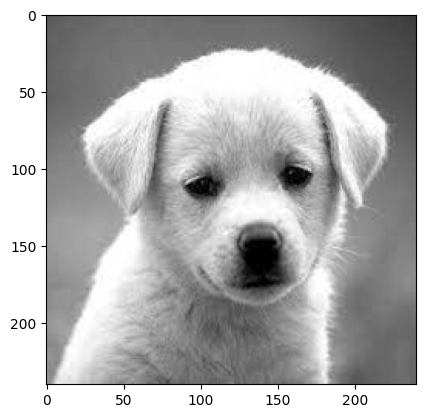

In [65]:
image = Image.open("./data/dog.jpeg").convert('L')
# superabundant number
dog_arr = np.asarray(image.resize((240, 240)))
plt.imshow(dog_arr, cmap=plt.get_cmap('gray'))
N = dog_arr.shape[0]
print((N, N))

In [66]:
sound_test, sound_test_sr = sf.read("./data/Cipher_sample.flac")
Audio(sound_test, rate=sound_test_sr)

# SVD-based Solution

Baker's map achieves multiple goals at once: protects the watermark from bad agents and distributes potential damage done to the watermark by various attacks, discussed later.

In [67]:
def chaotic_map(watermark, key):
    assert watermark.shape[0] == watermark.shape[1]
    N = watermark.shape[0]
    assert np.sum(key) == N, "Invalid key"

    columns = np.split(watermark, np.cumsum(key), axis=1)
    columns.pop()
    assert all([np.prod(np.shape(c)) % N == 0 and np.prod(np.shape(c)) > N for c in columns]), "Invalid key"
    squares = [np.split(columns[i], key[i]) for i in range(len(columns))]
    squares = [np.reshape(np.flip(sq, axis=1), N, 'F') for sq_grp in squares for sq in sq_grp]
    return np.flip(np.array(squares), axis=1)

def chaotic_unmap(cypher, key):
    assert cypher.shape[0] == cypher.shape[1]
    N = cypher.shape[0]
    assert np.sum(key) == N, "Invalid key"
    rows = np.flip(cypher, axis=1)
    squares = []
    curr_row = 0
    for i in range(len(key)):
        column = []
        for ii in range(key[i]):
            column.append(np.flip(np.reshape(rows[curr_row], (key[i], N//key[i]), 'A'), axis=0).T)
            curr_row += 1
        squares.append(np.vstack(column))
    return np.hstack(squares)

The key idea of the algorithm is to slightly modify the eigenvalues of the audio signal by embedding the watermark in them.

In [82]:
def watermark_encoding(signal: np.array, watermark: np.array, key):
    assert watermark.shape[0] == watermark.shape[1]
    N = watermark.shape[0]

    watermark = chaotic_map(watermark, key)

    N_sgm = signal.shape[0] // (N**2)
    signal = np.resize(signal, N_sgm * N**2)
    segments = np.array_split(signal, N_sgm)

    segments = [np.reshape(s, (N, N)) for s in segments]
    Uws = []
    Vws = []
    S_init = []
    Bs = []
    for sgm in segments:
        U, S, V = np.linalg.svd(sgm)
        S_init.append(S)
        D = np.diag(S) + 0.01 * watermark / 255
        Uw, Sw, Vw = np.linalg.svd(D)
        Uws.append(Uw)
        Vws.append(Vw)
        Bs.append(np.reshape(U @ np.diag(Sw) @ V, (N**2)))

    return np.hstack(Bs), signal, S_init, Uws, Vws


Here we see the value of superabundant numbers: the key can be more varied.

In [69]:
K = [N//12, N//6, N//24, N//4, N//12, N//8, N//6, N//12]
wsignal, signal, S_init, Uws, Vws = watermark_encoding(sound_test, dog_arr, K)
sf.write("./samples/Cipher_watermarked.flac", wsignal, sound_test_sr)
sf.write("./samples/Cipher.flac", signal, sound_test_sr)
Audio(wsignal, rate = sound_test_sr)

In [83]:
def watermark_decoding(signal: np.array, S_init: np.array, Uws: np.array, Vws: np.array, key):
    N = len(S_init[0])

    N_sgm = signal.shape[0] // (N**2)
    signal = np.resize(signal, N_sgm * N**2)
    segments = np.array_split(signal, N_sgm)

    segments = [np.reshape(s, (N, N)) for s in segments]
    Ws = []
    for sgm, S, Uw, Vw in zip(segments, S_init, Uws, Vws):
        _, Sw, _ = np.linalg.svd(sgm)
        W = (Uw @ np.diag(Sw) @ Vw - np.diag(S)) * 255 / 0.01
        Ws.append(W)

    return [chaotic_unmap(w, key) for w in Ws]

For an undisturbed signal decoding is completely successful, and the image can be recovered.

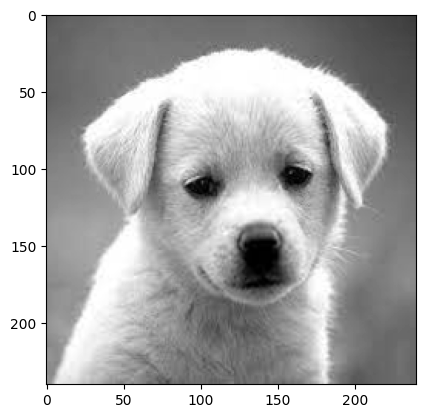

In [84]:
Ws = watermark_decoding(wsignal, S_init, Uws, Vws, K)
plt.imshow(Ws[0], cmap=plt.get_cmap('gray'))
plt.show()

Without a correct key a bad actor that somehow obtained correct supplementary information about the watermark (the matrices), cannot get the correct watermark.

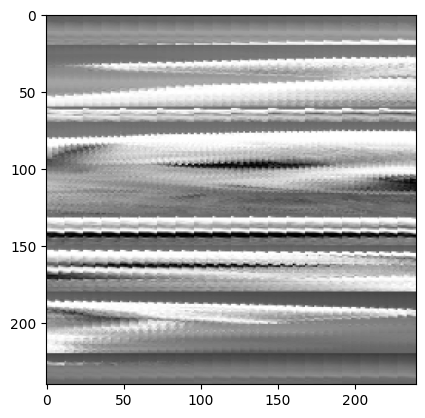

In [72]:
Ws = watermark_decoding(wsignal, S_init, Uws, Vws, [N])
plt.imshow(Ws[0], cmap=plt.get_cmap('gray'))
plt.show()

In [85]:
noise = np.random.normal(scale=0.01, size=len(wsignal))
noisy_signal = wsignal + noise
sf.write("./samples/Cipher_watermarked_noise.flac", noisy_signal, sound_test_sr)
sf.write("./samples/Cipher_noise.flac", signal + noise, sound_test_sr)
Audio(noisy_signal, rate = sound_test_sr)

# Attacks' overview

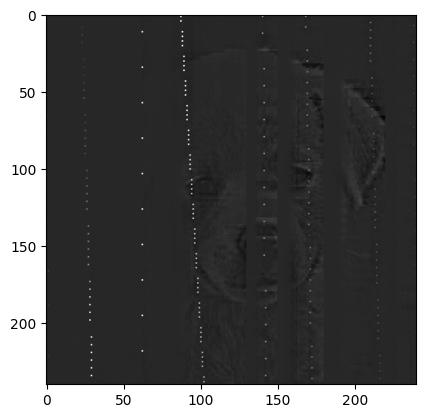

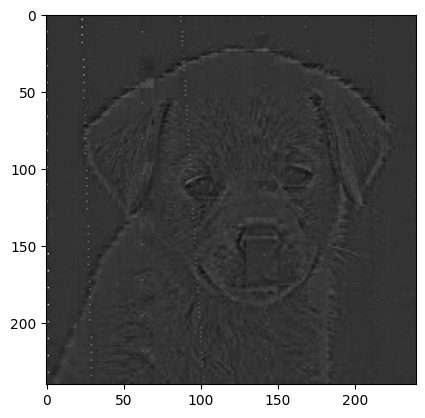

In [86]:
noiseWs = watermark_decoding(noisy_signal, S_init, Uws, Vws, K)
for W in [noiseWs[0], noiseWs[-1]]:
    plt.imshow(W, cmap=plt.get_cmap('gray'))
    plt.show()

The noise did damage the watermark but it is still recognizable. There is a similar effect to removing low frequency components in the image.

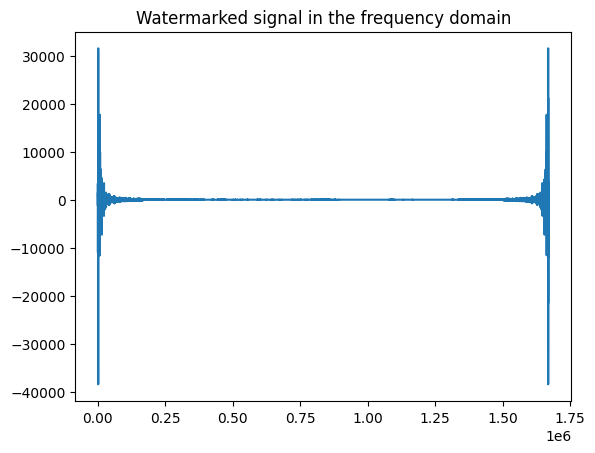

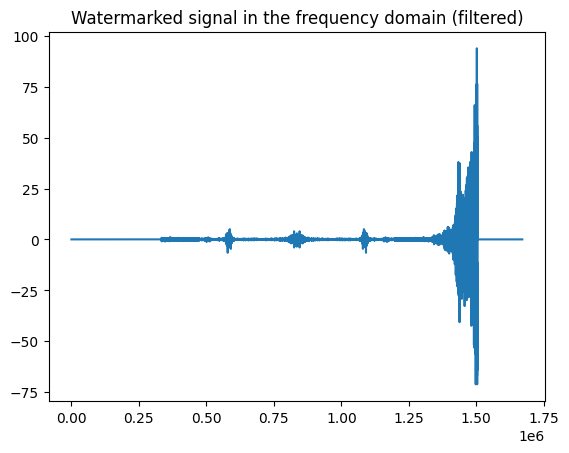

In [91]:
wfreq = fft(wsignal)

plt.plot(wfreq)
plt.title('Watermarked signal in the frequency domain')
plt.show()

wfreq[:2*len(wfreq)//10] = 0
wfreq[9*len(wfreq)//10:] = 0
filtered_signal = np.real(ifft(wfreq))

plt.plot(wfreq)
plt.title('Watermarked signal in the frequency domain (filtered)')
plt.show()

freq = fft(signal)
freq[:2*len(wfreq)//10] = 0
freq[9*len(wfreq)//10:] = 0

sf.write("./samples/Cipher_watermarked_filter.flac", filtered_signal, sound_test_sr)
sf.write("./samples/Cipher_filter.flac", np.real(ifft(freq)), sound_test_sr)
Audio(filtered_signal, rate=sound_test_sr)

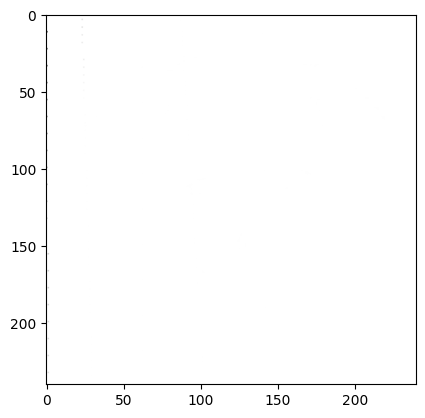

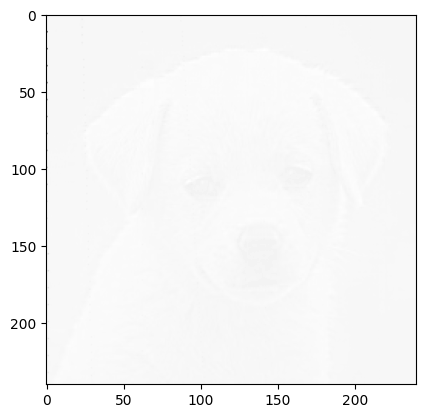

In [90]:
filtWs = watermark_decoding(filtered_signal, S_init, Uws, Vws, K)
for W in filtWs[-2:]:
    plt.imshow(W, cmap=plt.get_cmap('gray'))
    plt.show()

Even with filtering this intense the watermark is still not completely destroyed! It survived thanks to segmented structure of the algorithm: middling frequencies near the end of the piece were not wiped out.

In [15]:
compressed_signal, _ = sf.read("./samples/Cipher_watermarked.mp3")
Audio(compressed_signal, rate=sound_test_sr)

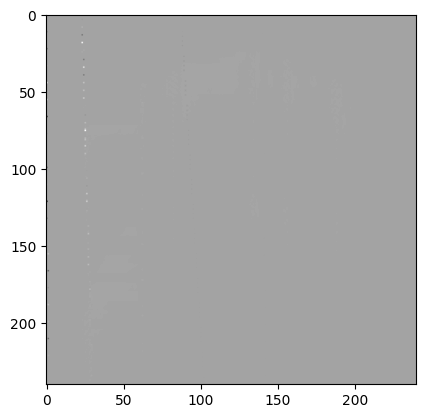

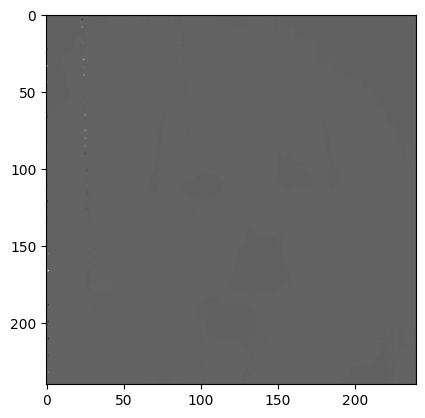

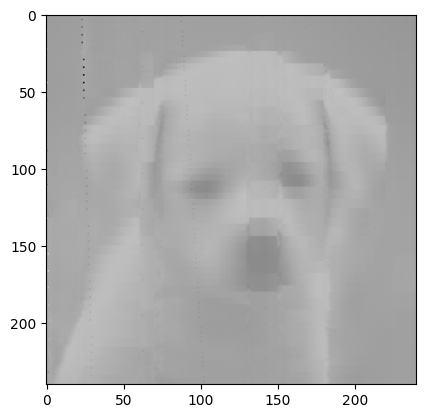

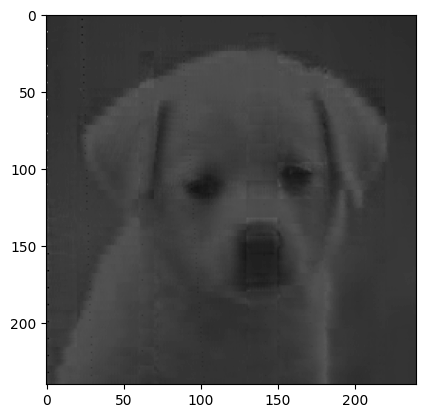

In [95]:
comprWs = watermark_decoding(compressed_signal, S_init, Uws, Vws, K)
for W in [comprWs[0], comprWs[10], comprWs[-2], comprWs[-1]]:
    plt.imshow(W, cmap=plt.get_cmap('gray'))
    plt.show()

The watermark even survived poor quality mp3 compression, as well. The watermark being more or less intelligible depends mostly on the psychoacoustic model used: where more masking occurs, the watermark was distorted more.

In [17]:
cropped_signal = np.hstack((wsignal[:int(N**2*4.5)], wsignal[-int(N**2*4):]))
cropped_ref_signal = np.hstack((signal[:int(N**2*4.5)], signal[-int(N**2*4):]))
sf.write("./samples/Cipher_watermarked_cropped.flac", cropped_signal, sound_test_sr)
sf.write("./samples/Cipher_cropped.flac", cropped_ref_signal, sound_test_sr)
Audio(cropped_signal, rate=sound_test_sr)

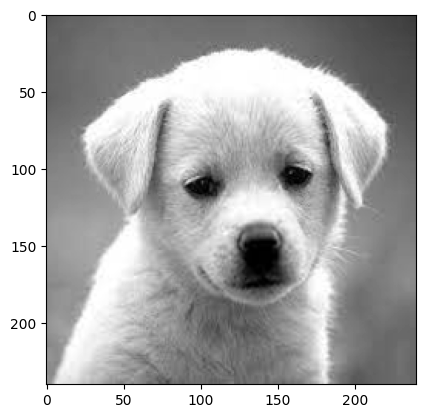

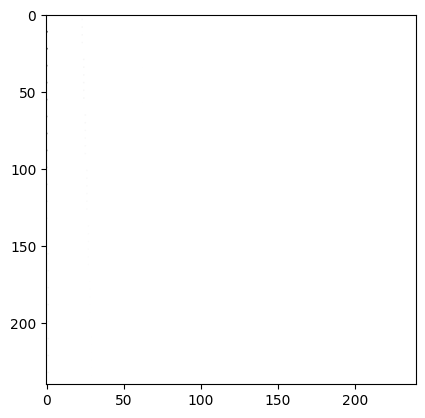

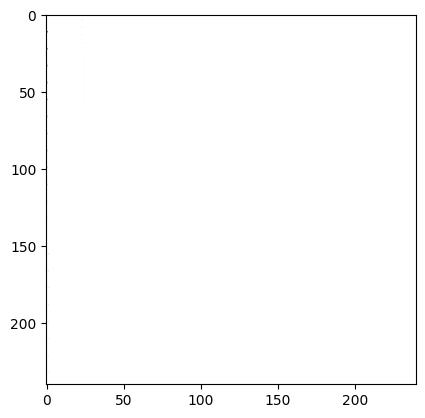

In [18]:
cropWs = watermark_decoding(cropped_signal, S_init, Uws, Vws, K)
for W in cropWs[3:6]:
    plt.imshow(W, cmap=plt.get_cmap('gray'))
    plt.show()

Cropping turned out to be the most effective attack on the watermark since this algorithm makes an explicit assumption about the segments' layout. Up to the first cut this approach can perfectly reconstruct the watermark, though.

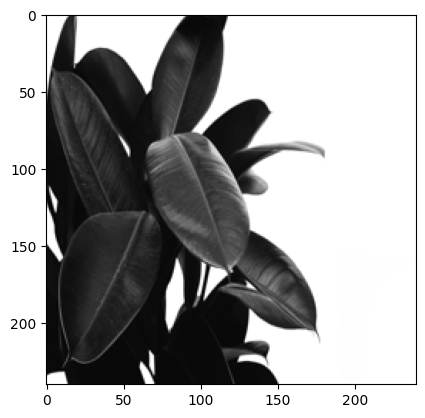

In [19]:
image = Image.open("./data/plant.jpg").convert('L')
plant_arr = np.asarray(image.resize((N, N)))
plt.imshow(plant_arr, cmap=plt.get_cmap('gray'))
plt.show()

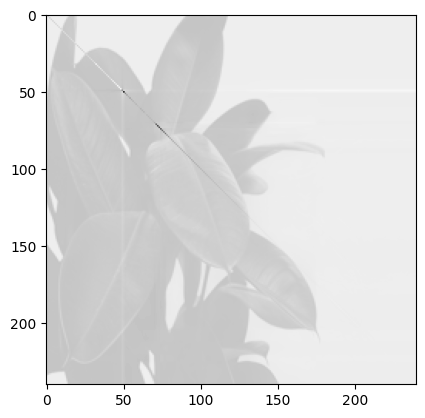

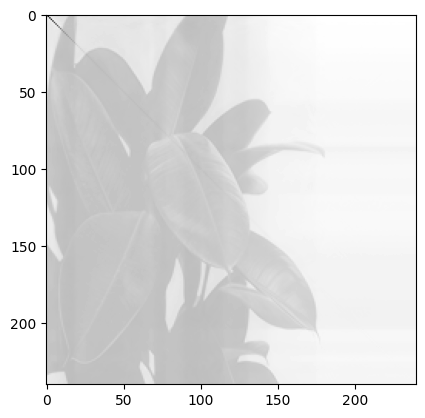

In [20]:
_, _, fakeS_init, fakeUws, fakeVws = watermark_encoding(signal, plant_arr, [N])
fakeWs = watermark_decoding(wsignal, fakeS_init, fakeUws, fakeVws, [N])
for W in [fakeWs[0], fakeWs[-1]]:
    plt.imshow(W, cmap=plt.get_cmap('gray'))
    plt.show()

If this algorithm did not use the Baker's map, it would be possible to embed arbitrary watermarks and confuse the decoder.

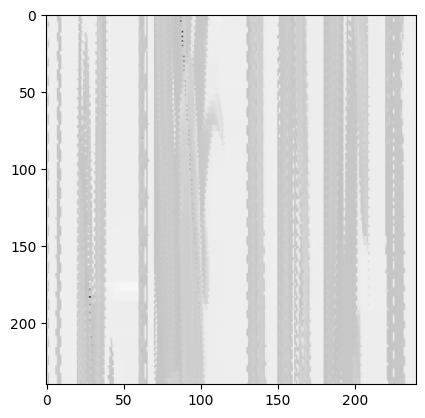

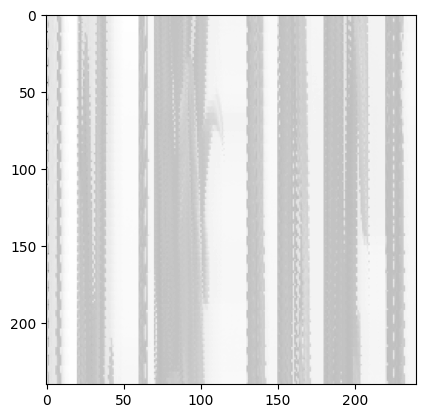

In [21]:
fakeWs = watermark_decoding(wsignal, fakeS_init, fakeUws, fakeVws, K)
for W in [fakeWs[0], fakeWs[-1]]:
    plt.imshow(W, cmap=plt.get_cmap('gray'))
    plt.show()

This example illustrates, that the fake watermark cannot fool the decoder, if the key is not cracked.

# Evaluation

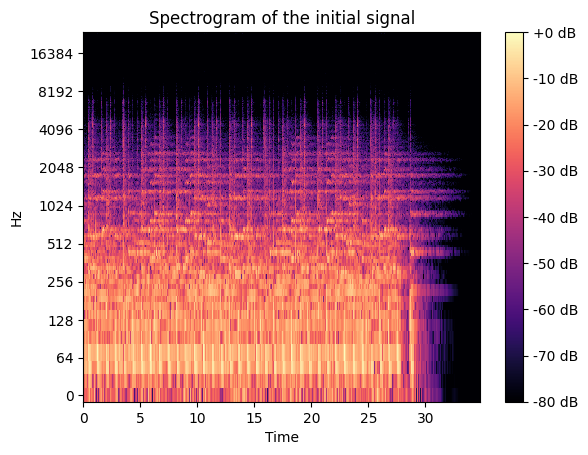

In [22]:
signal_db = librosa.amplitude_to_db(np.abs(librosa.stft(signal)), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(signal_db, x_axis='time', y_axis='log', sr=sound_test_sr, ax=ax)
ax.set(title='Spectrogram of the initial signal')
fig.colorbar(img, ax=ax, format="%+2.f dB")

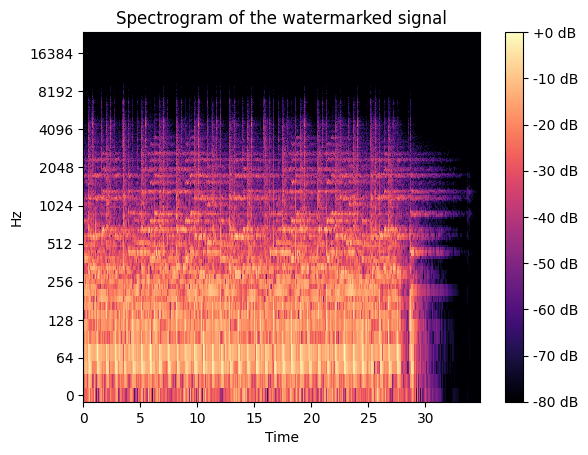

In [23]:
wsignal_db = librosa.amplitude_to_db(np.abs(librosa.stft(wsignal)), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(wsignal_db, x_axis='time', y_axis='log', sr=sound_test_sr, ax=ax)
ax.set(title='Spectrogram of the watermarked signal')
fig.colorbar(img, ax=ax, format="%+2.f dB")

A small distrorion is actually very visible at the end of the signal.

In [24]:
N_sgm = int(len(wsignal) // (2e-2 * sound_test_sr))
print(N_sgm)

1740


In [25]:
def snr_seq(input_s, output_s, n_sgm):
    assert len(input_s) == len(output_s)
    eps=np.finfo(np.float64).eps
    l_sgm = len(input_s) // n_sgm
    snr = 0
    for m in range(n_sgm):
        snr += np.log10(np.sum((eps + input_s[m*l_sgm:(m+1)*l_sgm] ** 2 / (eps + input_s[m*l_sgm:(m+1)*l_sgm] - output_s[m*l_sgm:(m+1)*l_sgm])) ** 2))
    return snr * 10 / n_sgm

In [26]:
print("SNRseg metric:")
print(f"Original: {snr_seq(signal, wsignal, N_sgm)}")
print(f"Noisy: {snr_seq(signal, noisy_signal, N_sgm)}")
print(f"Filtered: {snr_seq(signal, filtered_signal, N_sgm)}")
print(f"Compressed: {snr_seq(signal, compressed_signal, N_sgm)}")
print(f"Cropped: {snr_seq(cropped_ref_signal, cropped_signal, N_sgm)}")

SNRseg metric:
Original: 100.48714221135944
Noisy: 61.59348335561092
Filtered: 15.333464422448355
Compressed: 65.67150355720672
Cropped: 56.78418778088971


In [27]:
from scipy.linalg import toeplitz

def lpcoeff(speech_frame, model_order):
    eps=np.finfo(np.float64).eps

    winlength = max(speech_frame.shape)
    R = np.zeros((model_order+1,))
    for k in range(model_order+1):
        if k==0:
            R[k]=np.sum(speech_frame[0:]*speech_frame[0:])
        else:
            R[k]=np.sum(speech_frame[0:-k]*speech_frame[k:])
        

    a = np.ones((model_order,))
    a_past = np.ones((model_order,))
    rcoeff = np.zeros((model_order,))
    E = np.zeros((model_order+1,))

    E[0]=R[0]

    for i in range(0,model_order):
        a_past[0:i] = a[0:i]

        sum_term = np.sum(a_past[0:i]*R[i:0:-1])
		
        if E[i]==0.0:
            rcoeff[i]= np.inf
        else:
            rcoeff[i]=(R[i+1] - sum_term) / (E[i])
			
        a[i]=rcoeff[i]

        if i>0:
            a[0:i] = a_past[0:i] - rcoeff[i]*a_past[i-1::-1]

        E[i+1]=(1-rcoeff[i]*rcoeff[i])*E[i]

    acorr    = R;
    refcoeff = rcoeff;
    lpparams = np.ones((model_order+1,))
    lpparams[1:] = -a
    return(lpparams,R)

def llr(clean_speech, processed_speech, fs, used_for_composite=False, frameLen=0.03, overlap=0.75):
    eps=np.finfo(np.float64).eps
    alpha = 0.95
    winlength   = round(frameLen*fs)
    skiprate    = int(np.floor((1-overlap)*frameLen*fs))
    if fs<10000:
        P = 10
    else:
        P = 16
        
    hannWin=0.5*(1-np.cos(2*np.pi*np.arange(1,winlength+1)/(winlength+1)))
    clean_speech_framed=extract_overlapped_windows(clean_speech+eps,winlength,winlength-skiprate,hannWin)
    processed_speech_framed=extract_overlapped_windows(processed_speech+eps,winlength,winlength-skiprate,hannWin)
    numFrames=clean_speech_framed.shape[0]
    numerators = np.zeros((numFrames-1,))
    denominators = np.zeros((numFrames-1,))
    
    for ii in range(numFrames-1):
        A_clean,R_clean=lpcoeff(clean_speech_framed[ii,:],P)
        A_proc,R_proc=lpcoeff(processed_speech_framed[ii,:],P)
        
        numerators[ii]=A_proc.dot(toeplitz(R_clean).dot(A_proc.T))
        denominators[ii]=A_clean.dot(toeplitz(R_clean).dot(A_clean.T))
    
    
    frac=numerators/(denominators)
    frac[np.isnan(frac)]=np.inf
    frac[frac<=0]=1000
    distortion = np.log(frac)
    if not used_for_composite:
        distortion[distortion>2]=2
    distortion = np.sort(distortion)
    distortion = distortion[:int(round(len(distortion)*alpha))]
    return np.mean(distortion)

def extract_overlapped_windows(x,nperseg,noverlap,window=None):
    step = nperseg - noverlap
    shape = x.shape[:-1]+((x.shape[-1]-noverlap)//step, nperseg)
    strides = x.strides[:-1]+(step*x.strides[-1], x.strides[-1])
    result = np.lib.stride_tricks.as_strided(x, shape=shape,
                                             strides=strides)
    if window is not None:
        result = window * result
    return result

In [28]:
print("LLR metric:")
print(f"Original: {llr(signal, wsignal, sound_test_sr, overlap=0)}")
print(f"Noisy: {llr(signal, noisy_signal, sound_test_sr, overlap=0)}")
print(f"Filtered: {llr(signal, filtered_signal, sound_test_sr, overlap=0)}")
print(f"Compressed: {llr(signal, compressed_signal, sound_test_sr, overlap=0)}")
print(f"Cropped: {llr(cropped_ref_signal, cropped_signal, sound_test_sr, overlap=0)}")

LLR metric:
Original: 0.03594168108544372
Noisy: 1.972994721865071
Filtered: 2.0
Compressed: 1.9619626892370687
Cropped: 0.101249889938828


In [29]:
def sd(input_s, output_s, n_sgm):
    assert len(input_s) == len(output_s)
    l_sgm = len(input_s) // n_sgm
    v_i = fft(input_s)
    v_o = fft(output_s)
    total_sd = 0
    for m in range(n_sgm):
        total_sd += np.sum(np.abs(v_i[m*l_sgm:(m+1)*l_sgm] - v_o[m*l_sgm:(m+1)*l_sgm]))
    return total_sd / n_sgm

In [30]:
print("SD metric:")
print(f"Original: {sd(signal, wsignal, N_sgm)}")
print(f"Noisy: {sd(signal, noisy_signal, N_sgm)}")
print(f"Filtered: {sd(signal, filtered_signal, N_sgm)}")
print(f"Compressed: {sd(signal, compressed_signal, N_sgm)}")
print(f"Cropped: {sd(cropped_ref_signal, cropped_signal, N_sgm)}")

SD metric:
Original: 116.85570337800432
Noisy: 11001.777355626986
Filtered: 17316.384710226506
Compressed: 4586.984424585405
Cropped: 21.809083911349187


In [54]:
from sewar.full_ref import uqi

def corr_coeff(input_wm, output_wms):
    c = 0
    for output_wm in output_wms:
        c = max(uqi(input_wm, output_wm), c)
    return c

In [55]:
dog_arr_f64 = dog_arr.astype('float64')

print("Correlation coeff:")
print(f"Original: {corr_coeff(dog_arr_f64, Ws)}")
print(f"Noisy: {corr_coeff(dog_arr_f64, noiseWs)}")
print(f"Filtered: {corr_coeff(dog_arr_f64, filtWs)}")
print(f"Compressed: {corr_coeff(dog_arr_f64, comprWs)}")
print(f"Cropped: {corr_coeff(dog_arr_f64, cropWs)}")

Correlation coeff:
Original: 0.8372708871882025
Noisy: 0.4224743502034561
Filtered: 0.7108661615503878
Compressed: 0.9880238344744231
Cropped: 1.0000000000000164
